In [1]:
# Import necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import pickle

In [2]:
# Load Data
df = pd.read_csv("C:/Users/TeZZa/Downloads/PrepVector_ML_Sindhu/EnergyPredictor/PJME_hourly.csv")
df.head()

,Datetime,PJME_MW
0,2002-12-31 01:00:00,26498.0
1,2002-12-31 02:00:00,25147.0
2,2002-12-31 03:00:00,24574.0
3,2002-12-31 04:00:00,24393.0
4,2002-12-31 05:00:00,24860.0


In [3]:
# Convert Datetime column to proper format
df['Datetime'] = pd.to_datetime(df['Datetime'], errors='coerce')#ensuring date time field is in datetime format
# Sort by Datetime
df.sort_values(by=['Datetime'], ascending=True, inplace=True)#sort values of the column
# Drop NaT values
df.dropna(subset=['Datetime'], inplace=True)
# Set Datetime as index (without keeping a duplicate column)
df.set_index('Datetime', inplace=True)
# Verify the changes
print(df.info())  # Ensures Datetime is the index
# Check if the index is properly formatted
print(f"Data type of index: {df.index.dtype}")
print(f"Minimum date in data: {df.index.min()}, Maximum date: {df.index.max()}")

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 145366 entries, 2002-01-01 01:00:00 to 2018-08-03 00:00:00
Data columns (total 1 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   PJME_MW  145366 non-null  float64
dtypes: float64(1)
memory usage: 2.2 MB
None
Data type of index: datetime64[ns]
Minimum date in data: 2002-01-01 01:00:00, Maximum date: 2018-08-03 00:00:00


In [5]:
# Check missing timestamps- found 30 missing stamps
date_range = pd.date_range(start=df.index.min(), end=df.index.max(), freq='H')
missing_timestamps = date_range.difference(df.index)

# Fill missing values using forward fill
df.fillna(method='ffill', inplace=True)
print(f"Number of missing timestamps: {len(missing_timestamps)}")
if len(missing_timestamps) > 0:
    print(missing_timestamps)
duplicate_timestamps = df.index[df.index.duplicated()]
print(f"Number of duplicate timestamps: {len(duplicate_timestamps)}") # 4 duplicates
if len(duplicate_timestamps) > 0:
    print(duplicate_timestamps)
df = df[~df.index.duplicated(keep='last')]  # Keeps last occurrence of duplicates
# Reindex to include all hourly timestamps
date_range = pd.date_range(start=df.index.min(), end=df.index.max(), freq='h')
df = df.reindex(date_range)  # No ValueError since duplicates are gone


Number of missing timestamps: 0
Number of duplicate timestamps: 0


C:\Users\TeZZa\AppData\Local\Temp\ipykernel_15468\1774030127.py:2: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  date_range = pd.date_range(start=df.index.min(), end=df.index.max(), freq='H')
C:\Users\TeZZa\AppData\Local\Temp\ipykernel_15468\1774030127.py:6: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df.fillna(method='ffill', inplace=True)


In [7]:
df.columns

Index(['PJME_MW'], dtype='object')

In [6]:
# checking missing values in Energy Column- there's no missingness
print(df[df['PJME_MW'].isnull()])

Empty DataFrame
Columns: [PJME_MW]
Index: []


In [7]:
# checking if invalid dates exist here because of improper indexing
invalid_dates = df[(df.index.year < 2002) | (df.index.year > 2018)]
print(invalid_dates)


Empty DataFrame
Columns: [PJME_MW]
Index: []


In [8]:
# Feature engineering (Keeping `DatetimeIndex`)
df['dow'] = df.index.dayofweek
df['doy'] = df.index.dayofyear
df['year'] = df.index.year
df['month'] = df.index.month
df['quarter'] = df.index.quarter
df['hour'] = df.index.hour
df['weekday'] = df.index.weekday
df['woy'] = df.index.isocalendar().week
df['dom'] = df.index.day
df['season'] = df['month'].apply(lambda x: (x % 12 + 3) // 3)
df['weekend'] = df['weekday'].apply(lambda x: 1 if x >= 5 else 0)

In [37]:
df.head(5)
#df.columns
file_path = "C:\\Users\\TeZZa\\Downloads\\PrepVector_ML_Sindhu\\EnergyPredictor\\final_data.csv"


# Save the DataFrame with 'date_time' as a visible column
final_data = df.to_csv(file_path, index=True) 


In [12]:
# Aggregate yearly energy demand (taking the mean for each year)
df_yearly = df.groupby('year', as_index=False)['PJME_MW'].mean()

# Plot yearly energy demand trends
fig = px.line(df_yearly,
              x='year',
              y='PJME_MW',
              title=f'Power Demand (MW) over time [{df_yearly["year"].min()} - {df_yearly["year"].max()}]')

fig.update_traces(line=dict(width=1.5))
fig.update_layout(xaxis_title='Year', yaxis_title='Energy Demand [MW]')
fig.show()

In [131]:
print(df.columns)

Index(['PJME_MW', 'dow', 'doy', 'year', 'month', 'quarter', 'hour', 'weekday',
       'woy', 'dom', 'date', 'season', 'weekend'],
      dtype='object')


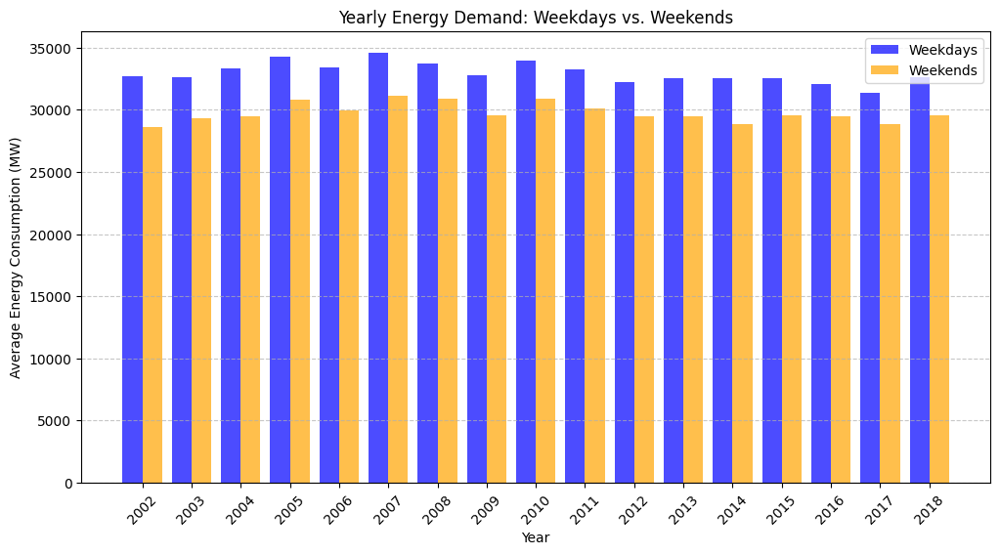

In [17]:
import matplotlib.pyplot as plt
import numpy as np

# Aggregate yearly energy demand for weekdays and weekends
yearly_weekday_demand = df[df['weekend'] == 0].groupby(df['year'])['PJME_MW'].mean()
yearly_weekend_demand = df[df['weekend'] == 1].groupby(df['year'])['PJME_MW'].mean()

# Create bar positions
years = yearly_weekday_demand.index
bar_width = 0.4
x = np.arange(len(years))

# Plot bars
plt.figure(figsize=(12, 6))
plt.bar(x - bar_width/2, yearly_weekday_demand, width=bar_width, label="Weekdays", alpha=0.7, color='blue')
plt.bar(x + bar_width/2, yearly_weekend_demand, width=bar_width, label="Weekends", alpha=0.7, color='orange')

# Formatting
plt.xlabel("Year")
plt.ylabel("Average Energy Consumption (MW)")
plt.title("Yearly Energy Demand: Weekdays vs. Weekends")
plt.xticks(ticks=x, labels=years, rotation=45)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Show plot
plt.show()


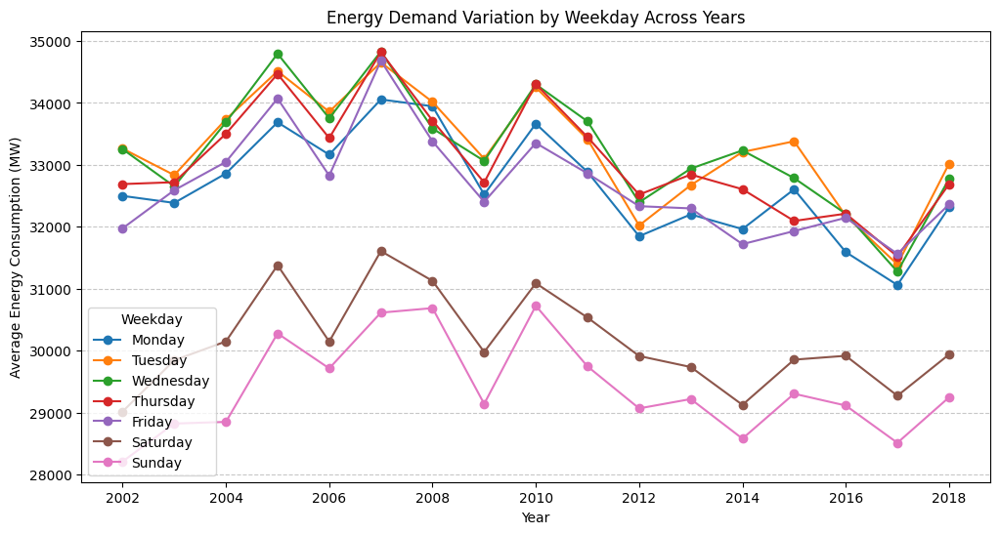

In [18]:
import matplotlib.pyplot as plt

# Group by year and weekday to get the mean energy demand
weekday_variation = df.groupby(['year', 'weekday'])['PJME_MW'].mean().unstack()

# Plot each weekday's variation across years
plt.figure(figsize=(12, 6))
for weekday in range(7):  # Loop through Monday (0) to Sunday (6)
    plt.plot(weekday_variation.index, weekday_variation[weekday], marker='o', linestyle='-', label=f"Weekday {weekday}")

# Formatting
plt.xlabel("Year")
plt.ylabel("Average Energy Consumption (MW)")
plt.title("Energy Demand Variation by Weekday Across Years")
plt.legend(title="Weekday", labels=["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"])
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Show plot
plt.show()


##### *this graph was intersting because it shows overall Wednesdays the power consumption is almost always  higher from 2002 to 2018*

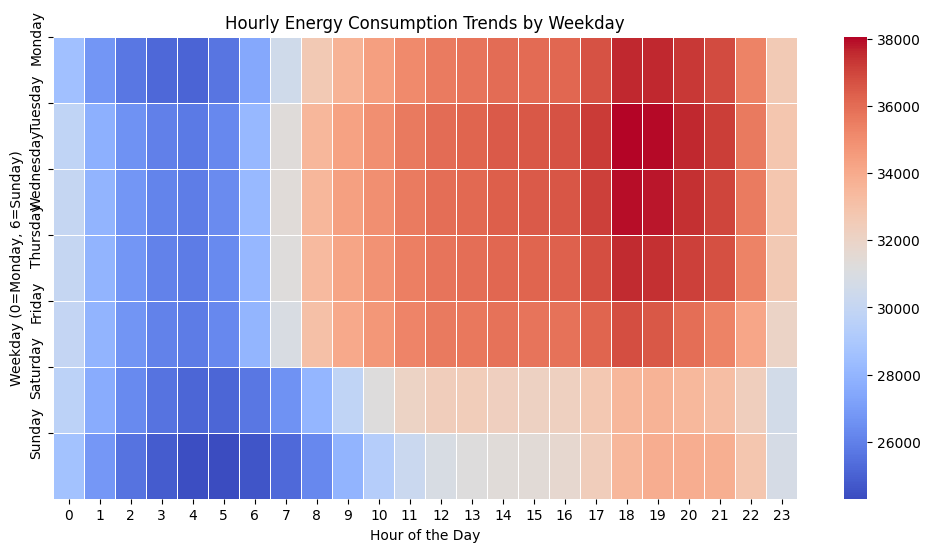

In [19]:
import matplotlib.pyplot as plt
import seaborn as sns

# Group by weekday and hour to compute average energy consumption
hourly_trends = df.groupby(['weekday', 'hour'])['PJME_MW'].mean().unstack()

# Plot energy demand for each weekday
plt.figure(figsize=(12, 6))
sns.heatmap(hourly_trends, cmap="coolwarm", annot=False, linewidths=0.5)

# Formatting
plt.xlabel("Hour of the Day")
plt.ylabel("Weekday (0=Monday, 6=Sunday)")
plt.title("Hourly Energy Consumption Trends by Weekday")
plt.yticks(ticks=range(7), labels=["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"])
plt.show()


#### and, during evenings from 4 pm to 9 pm the power consumption is more

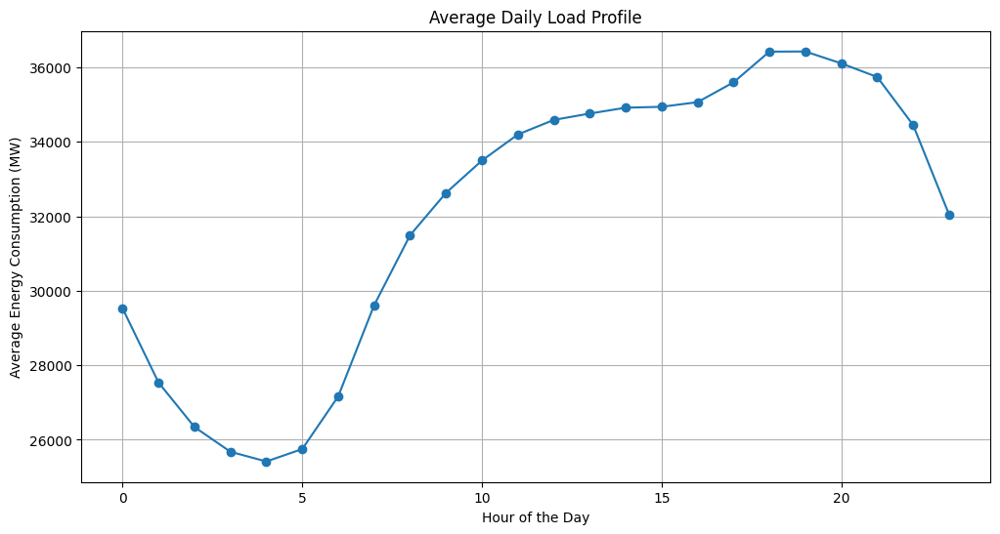

In [20]:
df.groupby('hour')['PJME_MW'].mean().plot(kind='line', figsize=(12, 6), marker='o')
plt.xlabel("Hour of the Day")
plt.ylabel("Average Energy Consumption (MW)")
plt.title("Average Daily Load Profile")
plt.grid()
plt.show()


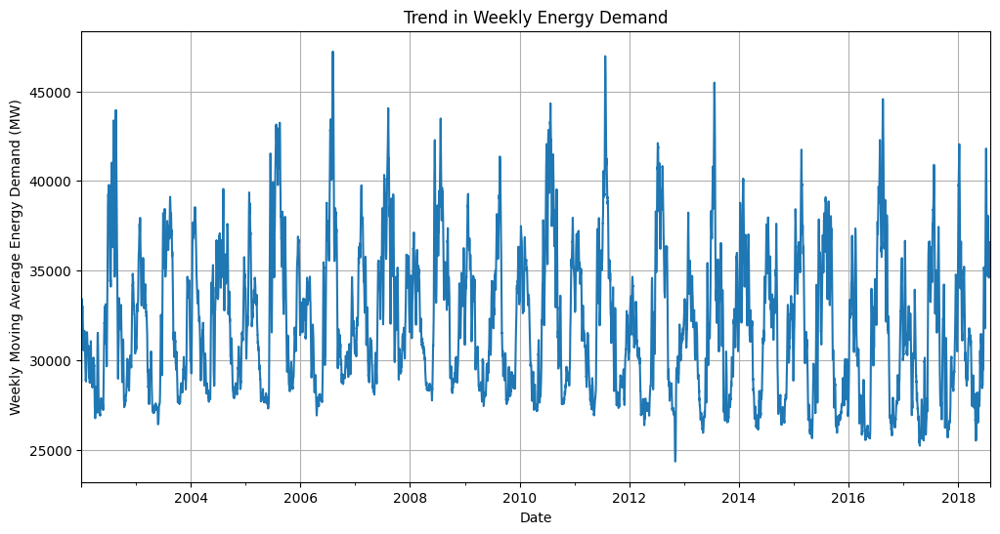

In [21]:
df['weekly_avg'] = df['PJME_MW'].rolling(window=7*24, min_periods=1).mean()
df['weekly_avg'].plot(figsize=(12, 6))
plt.xlabel("Date")
plt.ylabel("Weekly Moving Average Energy Demand (MW)")
plt.title("Trend in Weekly Energy Demand")
plt.grid()
plt.show()


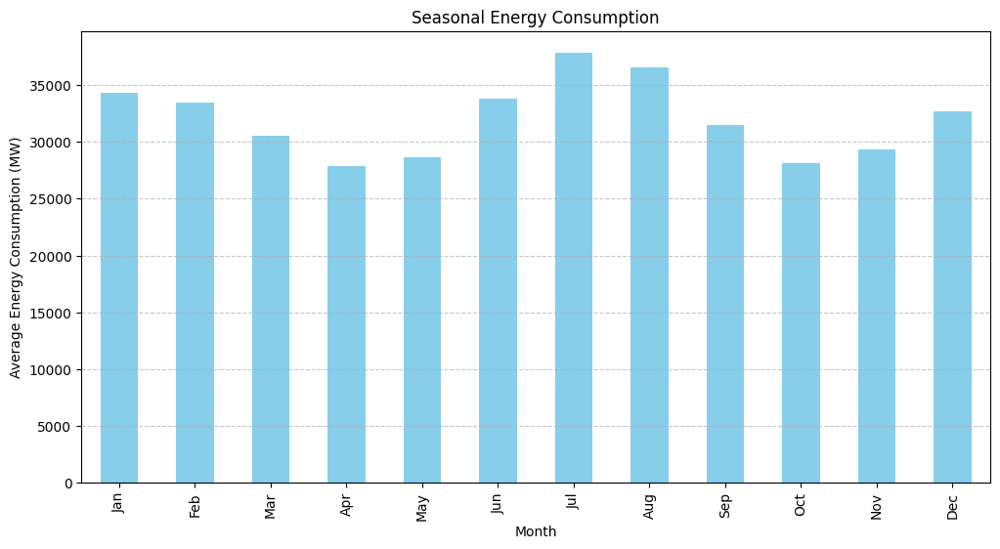

In [22]:
df.groupby('month')['PJME_MW'].mean().plot(kind='bar', figsize=(12,6), color='skyblue')
plt.xlabel("Month")
plt.ylabel("Average Energy Consumption (MW)")
plt.title("Seasonal Energy Consumption")
plt.xticks(ticks=range(12), labels=["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"])
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

#### its interesting to see some months with Public Holidays had more power consumption

### Next, I am decomposing timeseries to Trend, Seasonal, and Residual components

In [24]:
# draw a line plot of the data
fig = px.line(decomposed.trend,
        y="trend",
        title="Trend",
        height=300)
        
# adjust line width
fig.update_traces(line=dict(width=2))
        
# change layout of axes and the figure's margins 
# to emulate tight_layout
fig.update_layout(
        xaxis=dict(
        showticklabels=False,
        linewidth=1
        ),
        yaxis=dict(title=''),
        margin=go.layout.Margin(
            l=40, r=40, b=0, t=40, pad=0
        ),
    )
        
# display
fig.show()

In [25]:
# draw a line plot of the data
fig = px.line(decomposed.seasonal,
        y="seasonal",
        title="Seasonality",
        height=300)
        
# adjust line width
fig.update_traces(line=dict(width=0.025))
        
# change layout of axes and the figure's margins 
# to emulate tight_layout
fig.update_layout(
        xaxis=dict(
        showticklabels=False,
        linewidth=1
        ),
        yaxis=dict(title=''),
        margin=go.layout.Margin(
            l=40, r=40, b=0, t=40, pad=0
        ),
    )
        
# display
fig.show()

In [26]:
# draw a line plot of the data
fig = px.line(decomposed.resid,
        y="resid",
        title="Residuals",
        height=300)
        
# adjust line width
fig.update_traces(line=dict(width=0.5))
        
# change layout of axes and the figure's margins 
# to emulate tight_layout
fig.update_layout(
        xaxis=dict(
        showticklabels=False,
        linewidth=1
        ),
        yaxis=dict(title=''),
        margin=go.layout.Margin(
            l=40, r=40, b=0, t=40, pad=0
        ),
    )
        
# display
fig.show()

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 145392 entries, 2002-01-01 01:00:00 to 2018-08-03 00:00:00
Freq: h
Data columns (total 12 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   PJME_MW  145392 non-null  float64
 1   dow      145392 non-null  int32  
 2   doy      145392 non-null  int32  
 3   year     145392 non-null  int32  
 4   month    145392 non-null  int32  
 5   quarter  145392 non-null  int32  
 6   hour     145392 non-null  int32  
 7   weekday  145392 non-null  int32  
 8   woy      145392 non-null  UInt32 
 9   dom      145392 non-null  int32  
 10  season   145392 non-null  int64  
 11  weekend  145392 non-null  int64  
dtypes: UInt32(1), float64(1), int32(8), int64(2)
memory usage: 9.6 MB


In [11]:
# Check for missing values
print(f"Missing values:\n{df.isnull().sum()}")

# Check for duplicates again
print(f"Duplicate timestamps: {df.index.duplicated().sum()}")

# Check if the index is properly formatted
print(f"Data type of index: {df.index.dtype}")

# Check if the data is continuous
print(f"Index frequency: {df.index.freq}")

# Display summary statistics
print(df['PJME_MW'].describe())


Missing values:
PJME_MW    0
dow        0
doy        0
year       0
month      0
quarter    0
hour       0
weekday    0
woy        0
dom        0
season     0
weekend    0
dtype: int64
Duplicate timestamps: 0
Data type of index: datetime64[ns]
Index frequency: <Hour>
count    145392.000000
mean      32079.045800
std        6464.162561
min       14544.000000
25%       27571.000000
50%       31420.000000
75%       35647.250000
max       62009.000000
Name: PJME_MW, dtype: float64


In [36]:
# Train-Test Split (Keeping `Datetime` as Index) 
CUTOFF_DATE = pd.Timestamp('2017-08-01')
TRAIN_START_DATE = max(df.index.min(), CUTOFF_DATE - pd.Timedelta(days=8 * 365))

train = df.loc[(df.index < CUTOFF_DATE) & (df.index >= TRAIN_START_DATE)].copy()
test = df.loc[df.index >= CUTOFF_DATE].copy()
file_path1 = "C:\\Users\\TeZZa\\Downloads\\PrepVector_ML_Sindhu\\EnergyPredictor\\test.csv"
# Save data to CSV
test.to_csv(file_path1, index=False)
file_path2 = "C:\\Users\\TeZZa\\Downloads\\PrepVector_ML_Sindhu\\EnergyPredictor\\train.csv"
# Save data to CSV
train.to_csv(file_path2, index=False)
print(f"Train Data: {train.shape}, Test Data: {test.shape}")

Train Data: (70080, 12), Test Data: (8809, 12)


In [13]:
print(f"Missing values:\n{df.isnull().sum()}")  # Check NaNs
print(f"Duplicate timestamps: {df.index.duplicated().sum()}")  # Check for duplicates
print(f"Data type of index: {df.index.dtype}")  # Should be datetime64[ns]
print(f"Index frequency: {df.index.freq}")  # Should not be None


Missing values:
PJME_MW    0
dow        0
doy        0
year       0
month      0
quarter    0
hour       0
weekday    0
woy        0
dom        0
season     0
weekend    0
dtype: int64
Duplicate timestamps: 0
Data type of index: datetime64[ns]
Index frequency: <Hour>


C:\Users\TeZZa\AppData\Roaming\Python\Python313\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
15:52:43 - cmdstanpy - INFO - Chain [1] start processing
15:54:04 - cmdstanpy - INFO - Chain [1] done processing
C:\Users\TeZZa\AppData\Local\Temp\ipykernel_15468\1282964827.py:18: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  future = pd.DataFrame({'ds': pd.date_range(start=df.index.max(), periods=8760, freq='H')})


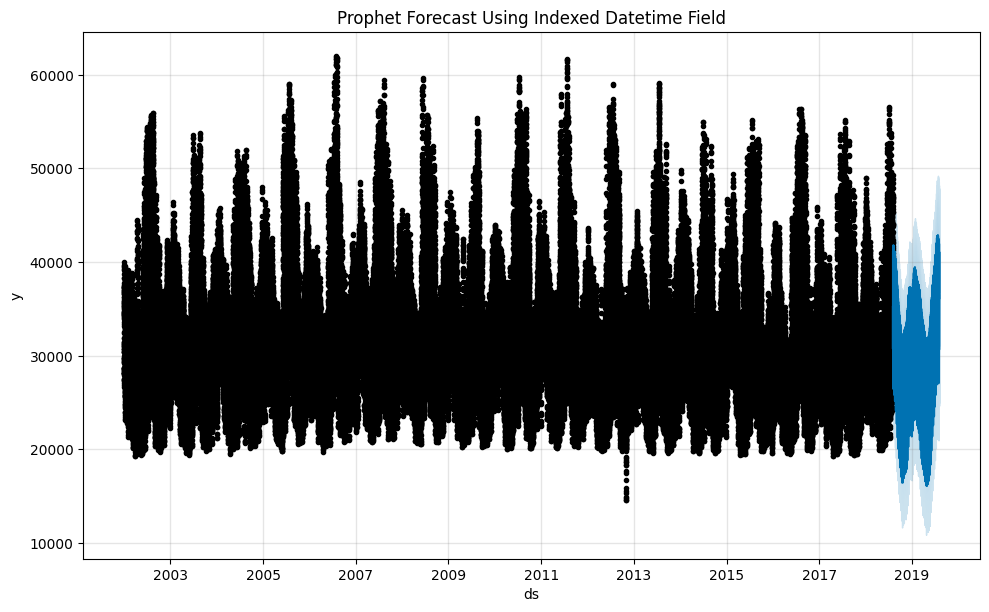

In [14]:
from prophet import Prophet
import pandas as pd
import matplotlib.pyplot as plt

# Ensure `Datetime` is already the index
df.index = pd.to_datetime(df.index)

# Prepare data for Prophet (keeping Datetime as index)
df_prophet = df[['PJME_MW']].copy()
df_prophet['ds'] = df.index  # Prophet requires 'ds' as the datetime column
df_prophet.rename(columns={'PJME_MW': 'y'}, inplace=True)

# Train Prophet Model
prophet_model = Prophet(yearly_seasonality=True, weekly_seasonality=True, daily_seasonality=True)
prophet_model.fit(df_prophet)

# Make Future Predictions
future = pd.DataFrame({'ds': pd.date_range(start=df.index.max(), periods=8760, freq='H')})
forecast = prophet_model.predict(future)

# Plot results
fig = prophet_model.plot(forecast)
plt.title("Prophet Forecast Using Indexed Datetime Field")
plt.show()


In [15]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np
import plotly.graph_objects as go

# Extract test dataset for evaluation
prophet_test = test[['PJME_MW']].copy()
prophet_test['ds'] = prophet_test.index  # Ensure `ds` matches Prophet format
prophet_test.rename(columns={'PJME_MW': 'y'}, inplace=True)

# Extract actual vs predicted data
y_hat_prophet = forecast[['ds', 'yhat']].set_index('ds')  # Forecasted values
prophet_test = prophet_test.set_index('ds')  # Ensure same index format

# Merge actual and predicted values
evaluation_df = prophet_test.merge(y_hat_prophet, left_index=True, right_index=True, how='inner')

# Calculate error metrics
mae = mean_absolute_error(evaluation_df['y'], evaluation_df['yhat'])
rmse = np.sqrt(mean_squared_error(evaluation_df['y'], evaluation_df['yhat']))
mape = np.mean(np.abs((evaluation_df['y'] - evaluation_df['yhat']) / evaluation_df['y'])) * 100

print(f"📊 Prophet Model Evaluation:")
print(f"MAE  (Mean Absolute Error): {mae:.2f}")
print(f"RMSE (Root Mean Square Error): {rmse:.2f}")
print(f"MAPE (Mean Absolute Percentage Error): {mape:.2f}%")



📊 Prophet Model Evaluation:
MAE  (Mean Absolute Error): 286.74
RMSE (Root Mean Square Error): 286.74
MAPE (Mean Absolute Percentage Error): 0.81%


#### MAE (286.74 MW):On average, the model's forecasted energy demand deviates by ~287 MW from actual values.
#### RMSE (286.74 MW):

#### RMSE penalizes larger errors more than MAE, but since both values are identical, this suggests errors are fairly consistent without large outliers.
#### MAPE (0.81%):

#### The model's error percentage is only 0.81%, meaning the forecast is very accurate compared to actual demand.
#### Typically, MAPE < 5% is considered an excellent forecast.

### For plotting purposes Adjusting test Data to have multiple years and running the model again to see the forecasts

In [16]:
print(f"Test Data Shape: {prophet_test.shape}")
print(f"Forecast Data Shape: {y_hat_prophet.shape}")
print(f"Merged Evaluation Data Shape: {evaluation_df.shape}")

# Print some sample values to confirm the data isn't empty
print(evaluation_df.head())


Test Data Shape: (8809, 1)
Forecast Data Shape: (8760, 1)
Merged Evaluation Data Shape: (1, 2)
                  y          yhat
ds                               
2018-08-03  35486.0  35199.261558


In [17]:
print("Unique years in test set:", prophet_test.index.year.unique())
print("Unique years in forecast:", y_hat_prophet.index.year.unique())
print("Unique years in evaluation_df:", evaluation_df.index.year.unique())


Unique years in test set: Index([2017, 2018], dtype='int32', name='ds')
Unique years in forecast: Index([2018, 2019], dtype='int32', name='ds')
Unique years in evaluation_df: Index([2018], dtype='int32', name='ds')


In [19]:
# Adjust test split to include multiple years
CUTOFF_DATE_ = pd.Timestamp('2015-01-01')  # Start test in 2015 instead of 2018

train_ = df.loc[df.index < CUTOFF_DATE].copy()
test_ = df.loc[df.index >= CUTOFF_DATE].copy()

print(f"Train Data: {train.shape}, Test Data: {test_.shape}")
print("Unique years in test set:", test_.index.year.unique())  # Should now have multiple years


Train Data: (70080, 12), Test Data: (8809, 12)
Unique years in test set: Index([2017, 2018], dtype='int32')


In [20]:
# Create past dates for Prophet to backtest its performance
historical_forecasts = pd.DataFrame({'ds': test_.index})

# Predict past test data
forecast = prophet_model.predict(historical_forecasts)

# Merge with test set for evaluation
y_hat_prophet = forecast[['ds', 'yhat']].set_index('ds')
prophet_test = test_[['PJME_MW']].copy()
prophet_test.rename(columns={'PJME_MW': 'y'}, inplace=True)

# Merge both
evaluation_df = prophet_test.merge(y_hat_prophet, left_index=True, right_index=True, how='inner')

# Check unique years
print("Unique years in evaluation_df:", evaluation_df.index.year.unique())  # Should now show multiple years


Unique years in evaluation_df: Index([2017, 2018], dtype='int32')


In [21]:
import plotly.graph_objects as go
import numpy as np

# Extract year as integer
evaluation_df['year'] = evaluation_df.index.year.astype(int)

# Ensure all years are included in the plot
all_years = np.arange(evaluation_df['year'].min(), evaluation_df['year'].max() + 1)
yearly_evaluation = evaluation_df.groupby('year')[['y', 'yhat']].mean().reindex(all_years, fill_value=np.nan)

# Create figure
fig = go.Figure()

# Add actual test data (ground truth)
fig.add_trace(go.Scatter(x=yearly_evaluation.index, y=yearly_evaluation["y"],
                         mode='lines+markers',
                         name='Test - Ground Truth', line=dict(color='black')))

# Add Prophet predicted values
fig.add_trace(go.Scatter(x=yearly_evaluation.index, y=yearly_evaluation["yhat"],
                         mode='lines+markers', 
                         name='Test - Prediction', line=dict(color='red', dash='dash')))

# Adjust layout
fig.update_layout(
    title='Prophet Forecast of Yearly Energy Demand',
    xaxis=dict(
        title='Year',
        tickmode='array',
        tickvals=yearly_evaluation.index,  # Show only whole years
        ticktext=[str(year) for year in yearly_evaluation.index]  # Ensure correct labels
    ),
    yaxis_title='Average Energy Demand [MW]',
    template="plotly_white"
)

# Show plot
fig.show()


In [22]:
import pickle

# Define model filename
model_filename = 'prophet_model.pkl'

# Save the trained Prophet model using pickle
with open(model_filename, 'wb') as model_file:
    pickle.dump(prophet_model, model_file)

print(f"✅ Prophet model saved as {model_filename}")


✅ Prophet model saved as prophet_model.pkl


✅ Prophet model successfully loaded!


C:\Users\TeZZa\AppData\Roaming\Python\Python313\site-packages\prophet\forecaster.py:1854: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.



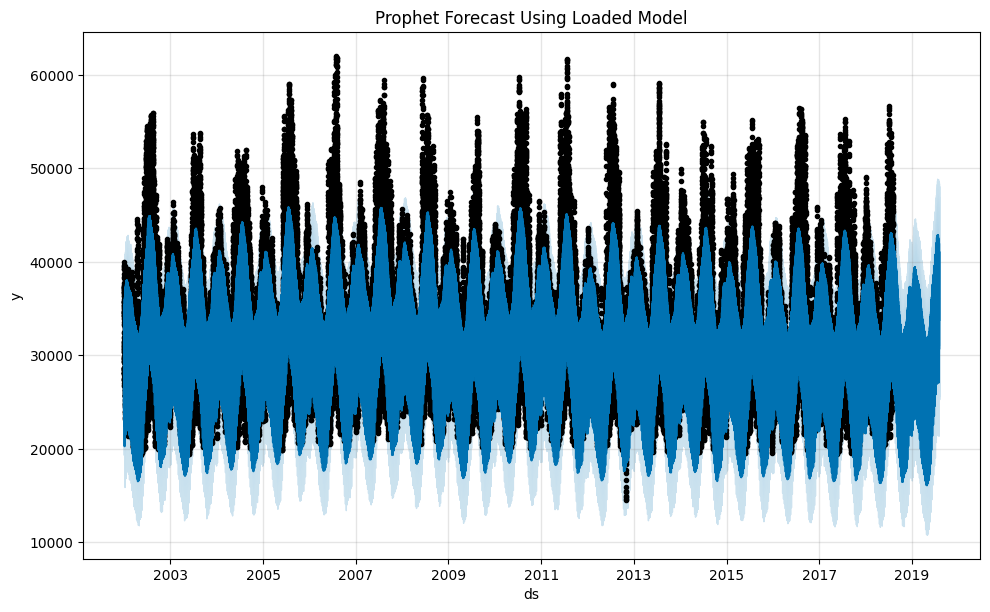

In [23]:
# Load the saved Prophet model
with open(model_filename, 'rb') as model_file:
    loaded_model = pickle.load(model_file)

print("✅ Prophet model successfully loaded!")

# Make Future Predictions (Next Year)
future = loaded_model.make_future_dataframe(periods=8760, freq='H')
forecast = loaded_model.predict(future)

# Plot results
import matplotlib.pyplot as plt
fig = loaded_model.plot(forecast)
plt.title("Prophet Forecast Using Loaded Model")
plt.show()


In [27]:
import os

model_path = "prophet_model.pkl"

if os.path.exists(model_path):
    print("✅ Model file exists!")
else:
    print("❌ Model file NOT found! You need to train and save it first.")


✅ Model file exists!


In [28]:
import os
import pickle
import pandas as pd
from prophet import Prophet

# Ensure 'ds' and 'y' columns exist for Prophet
df_prophet = df[['PJME_MW']].copy()
df_prophet['ds'] = df.index  # Prophet requires 'ds' as the datetime column
df_prophet.rename(columns={'PJME_MW': 'y'}, inplace=True)

# Train the Prophet Model
prophet_model = Prophet(yearly_seasonality=True, weekly_seasonality=True, daily_seasonality=True)
prophet_model.fit(df_prophet)

# Save the model
model_filename = "prophet_model.pkl"


with open(model_filename, "wb") as model_file:
    pickle.dump(prophet_model, model_file)

print(f"✅ Prophet model saved at {model_filename}")


16:15:48 - cmdstanpy - INFO - Chain [1] start processing
16:17:05 - cmdstanpy - INFO - Chain [1] done processing


✅ Prophet model saved at prophet_model.pkl


In [1]:
import pandas as pd

# Load the dataset
df = pd.read_csv("PJME_hourly.csv")

# Convert the first column to datetime
df.rename(columns={df.columns[0]: "ds"}, inplace=True)
df["ds"] = pd.to_datetime(df["ds"])

# Display the first and last available dates
print(f"Start Date: {df['ds'].min()}")
print(f"End Date: {df['ds'].max()}")

# Display unique years in the dataset
print("Available Years:", df["ds"].dt.year.unique())


Start Date: 2002-01-01 01:00:00
End Date: 2018-08-03 00:00:00
Available Years: [2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012 2013 2014 2015
 2016 2017 2018]


In [2]:
import pandas as pd

# Load forecast data
forecast_df = pd.read_csv("forecast.csv")

# Convert 'ds' column to datetime
forecast_df["ds"] = pd.to_datetime(forecast_df["ds"])

# Display the first and last available dates in the forecast
print(f"Forecast Start Date: {forecast_df['ds'].min()}")
print(f"Forecast End Date: {forecast_df['ds'].max()}")


Forecast Start Date: 2002-01-01 01:00:00
Forecast End Date: 2018-09-02 00:00:00
